<div style="float:left">
    <h1 style="width:600px">Part 1: Spatial Analysis</h1>
</div>
<div style="float:right"><img width="100" src="https://github.com/jreades/i2p/raw/master/img/casa_logo.jpg" /></div>

In [2]:
import datetime
now = datetime.datetime.now()
print("Last executed: " + now.strftime("%Y-%m-%d %H:%M:%S"))

Last executed: 2024-08-27 05:08:50


# 1. Library preparation

### Fiona & Gdal

In [5]:
import fiona
from osgeo import gdal

print(fiona.__version__)
print(gdal.__version__)

1.9.5
3.6.4


### Geopandas

In [7]:
import geopandas as gpd
print(gpd.__version__)
# import r5py as r5py
# from r5py.sampledata import helsinki, sao_paulo

0.14.2


### pyproj Lib

In [9]:
import pyproj
# 检查 pyproj 是否能正常工作
crs = pyproj.CRS("EPSG:27700")
print(crs)
# EPSG:27700

EPSG:27700


### Other Libs

In [11]:
import pandas as pd
from sklearn.linear_model import LinearRegression

import numpy as np

import sklearn
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import confusion_matrix

import matplotlib.pyplot as plt
import matplotlib
# import seaborn as sn

from time import time

### R5py

In [13]:
import r5py
print(r5py.__version__)

0.1.1


In [14]:
pip show r5py

Name: r5py
Version: 0.1.1
Summary: Python wrapper for the R5 routing analysis engine
Home-page: 
Author: Willem Klumpenhouwer, Marcus Sairava, Rafael Pereira, Henrikki Tenkanen
Author-email: Christoph Fink <christoph.fink@helsinki.fi>
License: GPL-3.0-or-later or MIT
Location: C:\Users\avb19\anaconda3\envs\r5py\Lib\site-packages
Requires: ConfigArgParse, filelock, fiona, geopandas, importlib-resources, joblib, jpype1, numpy, pandas, psutil, pyproj, requests, shapely
Required-by: 
Note: you may need to restart the kernel to use updated packages.


### Other_Libs

In [16]:
import shapely
print("shapely version:", shapely.__version__)

shapely version: 2.0.2


# Transport network

Virtually all operations of r5py require a transport network. R5py understands and reads the following types of transport networks:

a street network, including infrastructure for cycling and walking, is loaded from an OpenStreetMap extract in Protocol Buffer (.pbf) format (mandatory)

a public transport schedule from one or more GTFS files (optional).

For the quickstart example, you find sample data sets in the r5py.sampledata.helsinki package (see above).

To import the street and public transport networks, instantiate an r5py.TransportNetwork with the file paths to the OSM extract and to zero or more GTFS files. With the sample data set, the file paths are in the r5py.sampledata.helsinki namespace:

# London Start

# 1. File one: London LSOA Geojson

In [23]:
# Import Libs
import geopandas as gpd

# 读取.geojson文件 —— 加载时间在6-7分钟
London_LSOA_gdf = gpd.read_file("Data/London_second_phase/London_LSOA_2021.geojson")

In [24]:
London_LSOA_gdf.crs

<Projected CRS: EPSG:27700>
Name: OSGB36 / British National Grid
Axis Info [cartesian]:
- E[east]: Easting (metre)
- N[north]: Northing (metre)
Area of Use:
- name: United Kingdom (UK) - offshore to boundary of UKCS within 49°45'N to 61°N and 9°W to 2°E; onshore Great Britain (England, Wales and Scotland). Isle of Man onshore.
- bounds: (-9.0, 49.75, 2.01, 61.01)
Coordinate Operation:
- name: British National Grid
- method: Transverse Mercator
Datum: Ordnance Survey of Great Britain 1936
- Ellipsoid: Airy 1830
- Prime Meridian: Greenwich

In [25]:
# 将GeoDataFrame转换为DataFrame
London_LSOA_dropped = London_LSOA_gdf.to_crs(epsg='27700')

# London Library locations

# Cultural Infrastructure Map 2023

In [28]:
import pandas as pd

# 假设你的数据已经加载到 df 中
CIM_library = pd.read_csv('Data/London/CIM 2023 Libraries (Nov 2023).csv')

In [29]:
df = CIM_library.copy()

In [30]:
# 创建地理坐标系的 GeoDataFrame
gdf_geo = gpd.GeoDataFrame(df, geometry=gpd.points_from_xy(df.longitude, df.latitude))
gdf_geo = gdf_geo.set_crs(epsg=4326)

# 创建投影坐标系的 GeoDataFrame
gdf_proj = gpd.GeoDataFrame(df, geometry=gpd.points_from_xy(df.easting, df.northing))
gdf_proj = gdf_proj.set_crs(epsg=27700)

# 输出两个 GeoDataFrame 的 CRS 以验证
print(gdf_geo.crs)
print(gdf_proj.crs)

EPSG:4326
EPSG:27700


In [31]:
gdf_proj.head(2)

,name,address1,address2,address3,borough_name,website,os_addressbase_uprn,borough_code,ward_2022_name,ward_2022_code,latitude,longitude,easting,northing,geometry
0,Wembley Library,NaN,NaN,NaN,Brent,NaN,NaN,E09000005,Wembley Park,E05013516,51.558409,-0.279883,519339.8475,185793.3494,POINT (519339.847 185793.349)
1,Kilburn,NaN,NaN,NaN,Brent,NaN,202046410.0,E09000005,Queens Park,E05013507,51.534607,-0.203802,524678.5649,183273.2007,POINT (524678.565 183273.201)


# Compute a travel time matrix

### origins

In [34]:
origins = London_LSOA_dropped.copy()

In [35]:
origins['id'] = origins['FID'] 

In [36]:
# origins.crs
# #<Projected CRS: EPSG:27700>; Name: OSGB36 / British National Grid

In [37]:
origins.head(2)
# 这时geometry列为"polygon"

,FID,LSOA21CD,LSOA21NM,BNG_E,BNG_N,LONG,LAT,GlobalID,geometry,id
0,1,E01000001,City of London 001A,532123,181632,-0.09714,51.51816,c0565620-19c9-46e4-aea5-7031bb89b7d2,"POLYGON ((532151.537 181867.433, 532152.500 18...",1
1,2,E01000002,City of London 001B,532480,181715,-0.09197,51.51882,6aac6ffa-0cca-4aec-9a0a-1eeace1ea636,"POLYGON ((532634.497 181926.016, 532632.048 18...",2


In [38]:
origins_1 = origins.copy()

In [39]:
origins_1.geometry = origins_1.geometry.centroid
# 将geometry列从"polygon"转换为多边形的中心点"point"

In [40]:
origins_1.head(2)

,FID,LSOA21CD,LSOA21NM,BNG_E,BNG_N,LONG,LAT,GlobalID,geometry,id
0,1,E01000001,City of London 001A,532123,181632,-0.09714,51.51816,c0565620-19c9-46e4-aea5-7031bb89b7d2,POINT (532150.840 181617.461),1
1,2,E01000002,City of London 001B,532480,181715,-0.09197,51.51882,6aac6ffa-0cca-4aec-9a0a-1eeace1ea636,POINT (532443.368 181643.603),2


### destinations

In [42]:
destinations_all = gdf_proj.copy()

In [43]:
destinations_all["id"] = destinations_all.index

In [44]:
destinations_all.head(2)

,name,address1,address2,address3,borough_name,website,os_addressbase_uprn,borough_code,ward_2022_name,ward_2022_code,latitude,longitude,easting,northing,geometry,id
0,Wembley Library,NaN,NaN,NaN,Brent,NaN,NaN,E09000005,Wembley Park,E05013516,51.558409,-0.279883,519339.8475,185793.3494,POINT (519339.847 185793.349),0
1,Kilburn,NaN,NaN,NaN,Brent,NaN,202046410.0,E09000005,Queens Park,E05013507,51.534607,-0.203802,524678.5649,183273.2007,POINT (524678.565 183273.201),1


# Fulvio Method

In [46]:
import pandas as pd
import geopandas as gpd
from shapely.geometry import Point
from scipy.spatial import cKDTree

print(shapely.__version__)
# print(scipy.__version__)

2.0.2


# Population Density

In [48]:
import pandas as pd
Population_Density = pd.read_csv("Data/London/Population_Density_2022.csv")

In [49]:
# 替换列名中的空格和其他符号为下划线
Population_Density.columns = Population_Density.columns.str.replace(r'[^0-9a-zA-Z]+', '_', regex=True)

In [50]:
# 先将 Population_Density 的 'LSOA_2021_Code' 列重命名为 'LSOA21CD'
Population_Density.rename(columns={'LSOA_2021_Code': 'LSOA21CD'}, inplace=True)

In [51]:
Population_Density.head(5)

,LAD_2021_Code,LAD_2021_Name,LSOA21CD,LSOA_2021_Name,Mid_2022_population,Area_Sq_Km,People_per_Sq_Km
0,E06000001,Hartlepool,E01011949,Hartlepool 009A,"1,866",0.52,"3,596"
1,E06000001,Hartlepool,E01011950,Hartlepool 008A,"1,094",0.13,"8,257"
2,E06000001,Hartlepool,E01011951,Hartlepool 007A,"1,240",0.21,"5,944"
3,E06000001,Hartlepool,E01011952,Hartlepool 002A,"1,620",0.46,"3,491"
4,E06000001,Hartlepool,E01011953,Hartlepool 002B,"1,979",0.89,"2,220"


In [52]:
Population_Density.columns

Index(['LAD_2021_Code', 'LAD_2021_Name', 'LSOA21CD', 'LSOA_2021_Name',
       'Mid_2022_population', 'Area_Sq_Km', 'People_per_Sq_Km'],
      dtype='object')

In [53]:
Population_Density.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 35672 entries, 0 to 35671
Data columns (total 7 columns):
 #   Column               Non-Null Count  Dtype  
---  ------               --------------  -----  
 0   LAD_2021_Code        35672 non-null  object 
 1   LAD_2021_Name        35672 non-null  object 
 2   LSOA21CD             35672 non-null  object 
 3   LSOA_2021_Name       35672 non-null  object 
 4   Mid_2022_population  35672 non-null  object 
 5   Area_Sq_Km           35672 non-null  float64
 6   People_per_Sq_Km     35672 non-null  object 
dtypes: float64(1), object(6)
memory usage: 1.9+ MB


In [54]:
London_LSOA_dropped.shape

(4994, 9)

In [55]:
London_LSOA_dropped.head(5)

,FID,LSOA21CD,LSOA21NM,BNG_E,BNG_N,LONG,LAT,GlobalID,geometry
0,1,E01000001,City of London 001A,532123,181632,-0.097140,51.51816,c0565620-19c9-46e4-aea5-7031bb89b7d2,"POLYGON ((532151.537 181867.433, 532152.500 18..."
1,2,E01000002,City of London 001B,532480,181715,-0.091970,51.51882,6aac6ffa-0cca-4aec-9a0a-1eeace1ea636,"POLYGON ((532634.497 181926.016, 532632.048 18..."
2,3,E01000003,City of London 001C,532239,182033,-0.095320,51.52174,25c05f7b-d16f-4559-88b2-3e67c0c4372b,"POLYGON ((532153.703 182165.155, 532158.250 18..."
3,4,E01000005,City of London 001E,533581,181283,-0.076270,51.51468,3e34efd4-1211-4137-836f-1d121993a2ac,"POLYGON ((533619.062 181402.364, 533639.868 18..."
4,5,E01000006,Barking and Dagenham 016A,544994,184274,0.089317,51.53875,98105962-5ce2-42f6-ae3b-b1371e7fcb9f,"POLYGON ((545126.852 184310.838, 545145.213 18..."


In [56]:
London_LSOA_dropped.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 4994 entries, 0 to 4993
Data columns (total 9 columns):
 #   Column    Non-Null Count  Dtype   
---  ------    --------------  -----   
 0   FID       4994 non-null   int64   
 1   LSOA21CD  4994 non-null   object  
 2   LSOA21NM  4994 non-null   object  
 3   BNG_E     4994 non-null   int64   
 4   BNG_N     4994 non-null   int64   
 5   LONG      4994 non-null   float64 
 6   LAT       4994 non-null   float64 
 7   GlobalID  4994 non-null   object  
 8   geometry  4994 non-null   geometry
dtypes: float64(2), geometry(1), int64(3), object(3)
memory usage: 351.3+ KB


In [57]:
# 检查有多少值相同
matching_values = London_LSOA_dropped['LSOA21CD'].isin(Population_Density['LSOA21CD'])

# 统计相同值的数量
matching_count = matching_values.sum()

# 输出结果
print(f"共有 {matching_count} 个值在 London_LSOA_dropped['LSOA21CD'] 和 Population_Density['LSOA 2021 Code'] 中是相同的。")


共有 4994 个值在 London_LSOA_dropped['LSOA21CD'] 和 Population_Density['LSOA 2021 Code'] 中是相同的。


In [58]:
London_population_density = pd.merge(London_LSOA_dropped, 
                              Population_Density[['LSOA21CD', 'Mid_2022_population', 'Area_Sq_Km', 'People_per_Sq_Km']], 
                              on='LSOA21CD', 
                              how='left')

In [59]:
London_population_density.head(5)

,FID,LSOA21CD,LSOA21NM,BNG_E,BNG_N,LONG,LAT,GlobalID,geometry,Mid_2022_population,Area_Sq_Km,People_per_Sq_Km
0,1,E01000001,City of London 001A,532123,181632,-0.097140,51.51816,c0565620-19c9-46e4-aea5-7031bb89b7d2,"POLYGON ((532151.537 181867.433, 532152.500 18...","1,721",0.13,"13,259"
1,2,E01000002,City of London 001B,532480,181715,-0.091970,51.51882,6aac6ffa-0cca-4aec-9a0a-1eeace1ea636,"POLYGON ((532634.497 181926.016, 532632.048 18...","1,608",0.23,"7,043"
2,3,E01000003,City of London 001C,532239,182033,-0.095320,51.52174,25c05f7b-d16f-4559-88b2-3e67c0c4372b,"POLYGON ((532153.703 182165.155, 532158.250 18...","1,826",0.06,"31,002"
3,4,E01000005,City of London 001E,533581,181283,-0.076270,51.51468,3e34efd4-1211-4137-836f-1d121993a2ac,"POLYGON ((533619.062 181402.364, 533639.868 18...","1,605",0.19,"8,465"
4,5,E01000006,Barking and Dagenham 016A,544994,184274,0.089317,51.53875,98105962-5ce2-42f6-ae3b-b1371e7fcb9f,"POLYGON ((545126.852 184310.838, 545145.213 18...","1,833",0.15,"12,503"


In [60]:
London_population_density['People_per_Sq_Km'].isna().sum()

0

In [61]:
import pandas as pd

# 假设 London_population_density 已经定义

# 1. 移除可能的非数值字符（如逗号）
London_population_density['People_per_Sq_Km'] = London_population_density['People_per_Sq_Km'].str.replace(',', '').str.strip()

# 2. 将列转换为 float 类型
London_population_density['People_per_Sq_Km'] = London_population_density['People_per_Sq_Km'].astype(float)

# 检查转换结果
London_population_density['People_per_Sq_Km'].dtypes


dtype('float64')

In [62]:
# 将Final_df转换为GeoDataFrame
London_population_density_gpd = gpd.GeoDataFrame(London_population_density, geometry='geometry')

In [63]:
vmin = London_population_density_gpd['People_per_Sq_Km'].min()
vmin

128.0

In [64]:
vmax = London_population_density_gpd['People_per_Sq_Km'].max()
vmax

115876.0

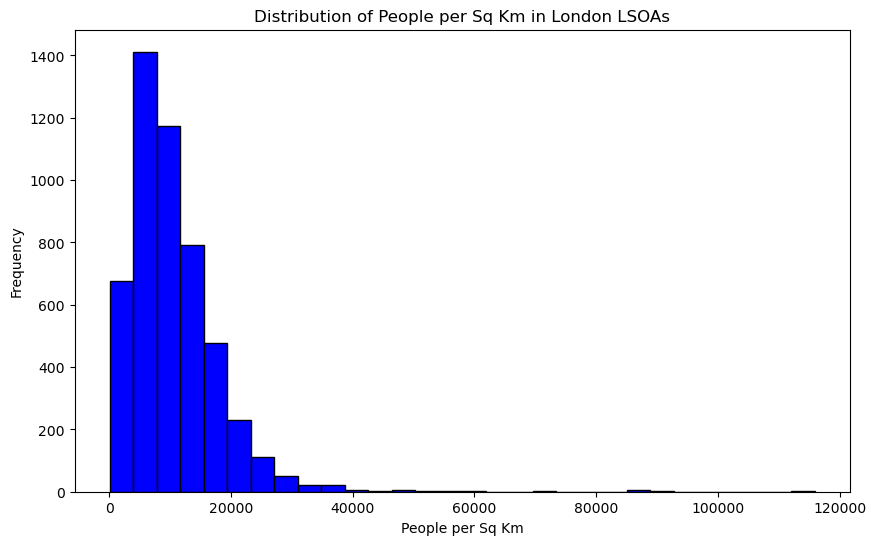

In [65]:
import matplotlib.pyplot as plt

# 绘制柱状图
plt.figure(figsize=(10, 6))
plt.hist(London_population_density_gpd['People_per_Sq_Km'], bins=30, color='blue', edgecolor='black')

# 添加标题和标签
plt.title('Distribution of People per Sq Km in London LSOAs')
plt.xlabel('People per Sq Km')
plt.ylabel('Frequency')

# 显示图表
plt.show()

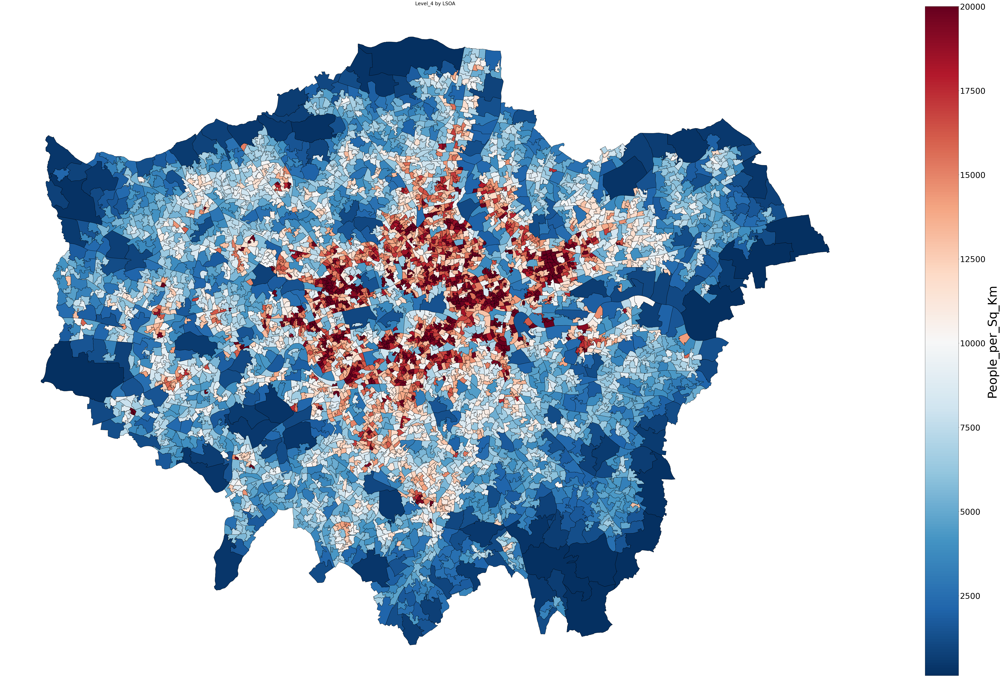

In [66]:
import geopandas as gpd
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors

# 将Final_df转换为GeoDataFrame
London_population_density_gpd = gpd.GeoDataFrame(London_population_density, geometry='geometry')

# 设置颜色映射的最小值和最大值
vmin = London_population_density_gpd['People_per_Sq_Km'].min()
vmax = 20000  # 手动设置 colorbar 的最大值为 40000

# 绘制地图并根据 employment_rate 列的值进行着色
fig, ax = plt.subplots(1, 1, figsize=(100, 60))  # 调整大小为更适合屏幕显示的比例
cmap = 'RdBu_r'
# cmap = 'coolwarm'
norm = mcolors.Normalize(vmin=vmin, vmax=vmax)

# 使用GeoDataFrame的plot函数来绘制地图
London_population_density_gpd.plot(column='People_per_Sq_Km', cmap=cmap, legend=False, norm=norm, ax=ax, edgecolor='black')

# 隐藏坐标轴
ax.axis('off')

# 手动创建 colorbar
sm = plt.cm.ScalarMappable(cmap=cmap, norm=norm)
sm.set_array([])
cbar = fig.colorbar(sm, ax=ax)
cbar.set_label('People_per_Sq_Km', fontsize=60)  # 设置 colorbar 标签的字体大小
cbar.ax.tick_params(labelsize=40)  # 设置 colorbar 刻度标签的字体大小

plt.title('Level_4 by LSOA', fontsize=24)
plt.show()


In [67]:
destinations_all.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 347 entries, 0 to 346
Data columns (total 16 columns):
 #   Column               Non-Null Count  Dtype   
---  ------               --------------  -----   
 0   name                 347 non-null    object  
 1   address1             4 non-null      object  
 2   address2             1 non-null      object  
 3   address3             0 non-null      float64 
 4   borough_name         347 non-null    object  
 5   website              0 non-null      float64 
 6   os_addressbase_uprn  342 non-null    float64 
 7   borough_code         347 non-null    object  
 8   ward_2022_name       346 non-null    object  
 9   ward_2022_code       346 non-null    object  
 10  latitude             347 non-null    float64 
 11  longitude            347 non-null    float64 
 12  easting              347 non-null    float64 
 13  northing             347 non-null    float64 
 14  geometry             347 non-null    geometry
 15  id             

In [68]:
destinations_all.head()

,name,address1,address2,address3,borough_name,website,os_addressbase_uprn,borough_code,ward_2022_name,ward_2022_code,latitude,longitude,easting,northing,geometry,id
0,Wembley Library,NaN,NaN,NaN,Brent,NaN,NaN,E09000005,Wembley Park,E05013516,51.558409,-0.279883,519339.8475,185793.3494,POINT (519339.847 185793.349),0
1,Kilburn,NaN,NaN,NaN,Brent,NaN,2.020464e+08,E09000005,Queens Park,E05013507,51.534607,-0.203802,524678.5649,183273.2007,POINT (524678.565 183273.201),1
2,Bradmore Green,NaN,NaN,NaN,Croydon,NaN,2.000000e+11,E09000008,Old Coulsdon,E05011474,51.307033,-0.122405,530972.1080,158108.6541,POINT (530972.108 158108.654),2
3,Biggin Hill Memorial Library and Pool,NaN,NaN,NaN,Bromley,NaN,1.007001e+10,E09000006,Biggin Hill,E05013989,51.311701,0.036318,542020.3836,158922.5458,POINT (542020.384 158922.546),3
4,Coulsdon,NaN,NaN,NaN,Croydon,NaN,1.000000e+11,E09000008,Coulsdon Town,E05011466,51.319472,-0.137097,529913.0368,159465.8282,POINT (529913.037 159465.828),4


In [69]:
# import geopandas as gpd
# import matplotlib.pyplot as plt
# import matplotlib.colors as mcolors

# # 将Final_df转换为GeoDataFrame
# London_population_density_gpd = gpd.GeoDataFrame(London_population_density, geometry='geometry')

# # 设置颜色映射的最小值和最大值
# vmin = London_population_density_gpd['People_per_Sq_Km'].min()
# vmax = 20000  # 手动设置 colorbar 的最大值为 40000

# # 绘制地图并根据 employment_rate 列的值进行着色
# fig, ax = plt.subplots(1, 1, figsize=(100, 60))  # 调整大小为更适合屏幕显示的比例
# cmap = 'RdBu_r'
# # cmap = 'coolwarm'
# norm = mcolors.Normalize(vmin=vmin, vmax=vmax)

# # 使用GeoDataFrame的plot函数来绘制地图
# London_population_density_gpd.plot(column='People_per_Sq_Km', cmap=cmap, legend=False, norm=norm, ax=ax, edgecolor='black')

# # 叠加图书馆位置点，使用白色填充和黑色描边
# destinations_all.plot(ax=ax, marker='o', color='yellow', edgecolor='black', markersize=500)

# # 隐藏坐标轴
# ax.axis('off')

# # 手动创建 colorbar
# sm = plt.cm.ScalarMappable(cmap=cmap, norm=norm)
# sm.set_array([])
# cbar = fig.colorbar(sm, ax=ax)
# cbar.set_label('People_per_Sq_Km', fontsize=60)  # 设置 colorbar 标签的字体大小
# cbar.ax.tick_params(labelsize=40)  # 设置 colorbar 刻度标签的字体大小

# plt.title('Population Density with Public Libraries Distribution', fontsize=24)

# # 保存图片到指定路径
# plt.savefig("Plot_final_0826/Population_Density_Public_Libraries_Distribution.png")

# plt.show()


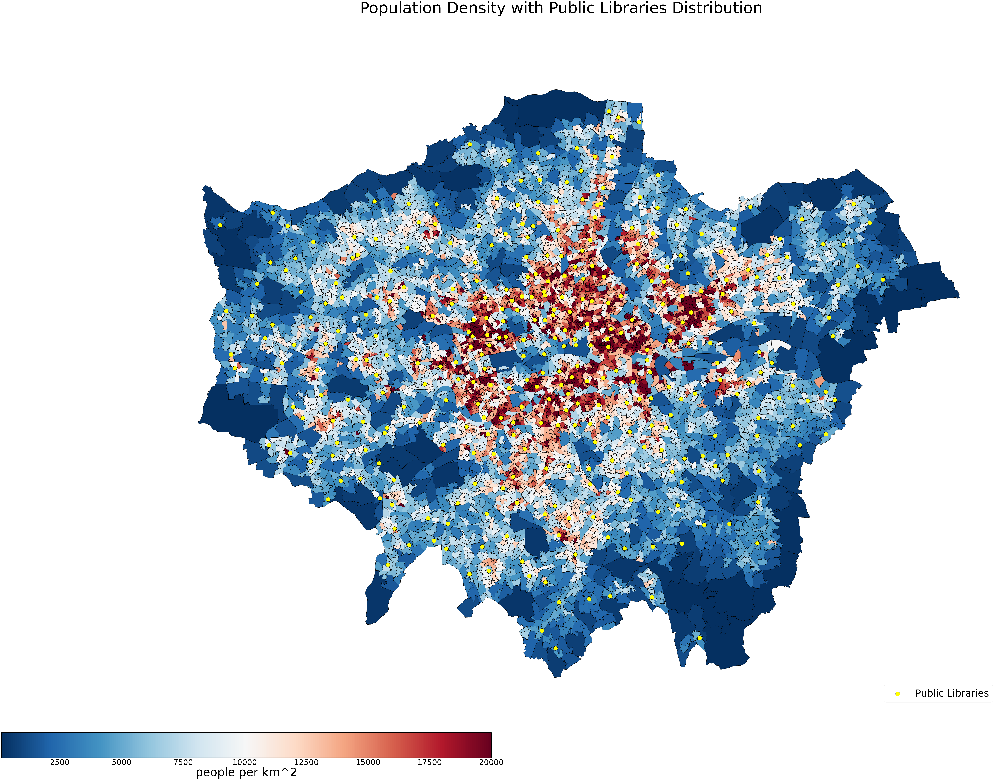

In [70]:
import geopandas as gpd
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors

# 将Final_df转换为GeoDataFrame
London_population_density_gpd = gpd.GeoDataFrame(London_population_density, geometry='geometry')

# 设置颜色映射的最小值和最大值
vmin = London_population_density_gpd['People_per_Sq_Km'].min()
vmax = 20000  # 手动设置 colorbar 的最大值为 20000

# 绘制地图并根据 People_per_Sq_Km 列的值进行着色
fig, ax = plt.subplots(1, 1, figsize=(100, 60))  # 调整大小为更适合屏幕显示的比例
cmap = 'RdBu_r'
norm = mcolors.Normalize(vmin=vmin, vmax=vmax)

# 使用GeoDataFrame的plot函数来绘制地图
London_population_density_gpd.plot(column='People_per_Sq_Km', cmap=cmap, legend=False, norm=norm, ax=ax, edgecolor='black')

# 叠加图书馆位置点，使用黄色填充和黑色描边
destinations_all.plot(ax=ax, marker='o', color='yellow', edgecolor='black', markersize=500, label='Public Libraries')

# 隐藏坐标轴
ax.axis('off')

# 手动创建横置的 colorbar，并将其放置在图的左半边
sm = plt.cm.ScalarMappable(cmap=cmap, norm=norm)
sm.set_array([])

# 在指定位置创建 colorbar 的轴并横置
cbar_ax = fig.add_axes([0.1, 0.05, 0.35, 0.03])  # [left, bottom, width, height]
cbar = fig.colorbar(sm, cax=cbar_ax, orientation='horizontal')
cbar.set_label('people per km^2', fontsize=60)  # 设置 colorbar 标签的字体大小
cbar.ax.tick_params(labelsize=40)  # 设置 colorbar 刻度标签的字体大小

# 在右侧添加公共图书馆的图例
ax.legend(loc='lower right', fontsize=50)

# 调整标题位置，使其位于图的上方
fig.suptitle('Population Density with Public Libraries Distribution', fontsize=80, y=0.95)
# plt.title('Population Density with Public Libraries Distribution', fontsize=80)

# 保存图片到指定路径
plt.savefig("Plot_final_0826/Population_Density_Public_Libraries_Distribution_with_Legend.png")

plt.show()


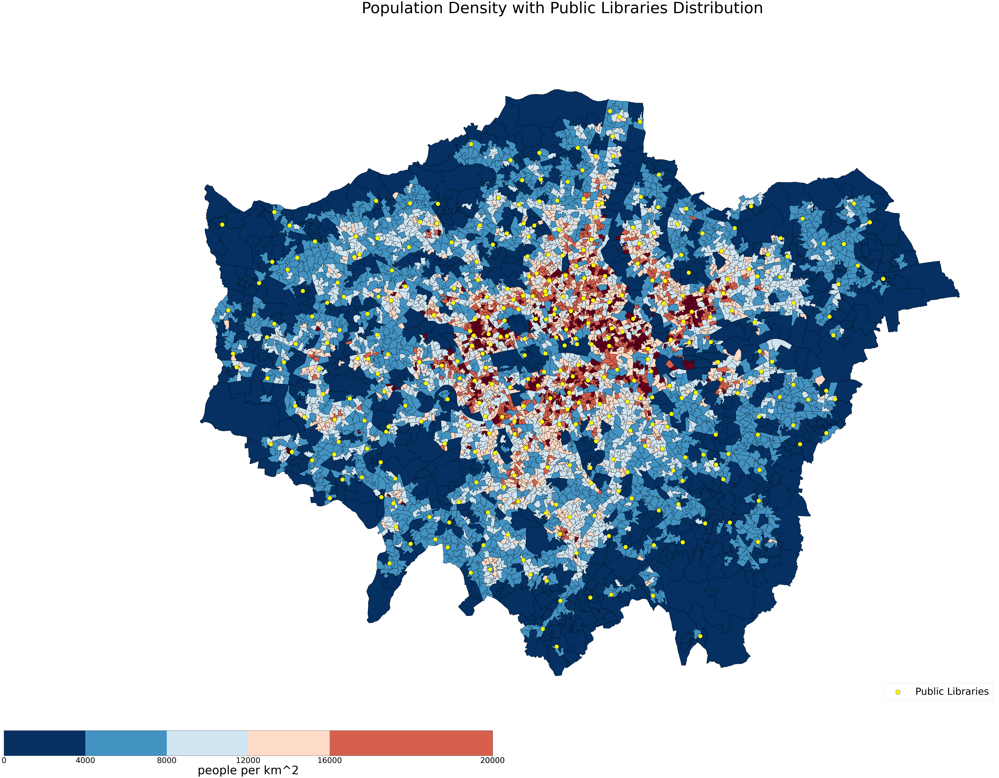

In [127]:
import geopandas as gpd
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors
import numpy as np

# 将Final_df转换为GeoDataFrame
London_population_density_gpd = gpd.GeoDataFrame(London_population_density, geometry='geometry')

# 设置颜色映射的最小值和最大值
vmin = London_population_density_gpd['People_per_Sq_Km'].min()
vmax = 20000  # 手动设置 colorbar 的最大值为 20000

# 自定义区间
boundaries = [0, 4000, 8000, 12000, 16000, 20000, vmax]
norm = mcolors.BoundaryNorm(boundaries, ncolors=256, clip=True)

# 绘制地图并根据 People_per_Sq_Km 列的值进行着色
fig, ax = plt.subplots(1, 1, figsize=(100, 60))  # 调整大小为更适合屏幕显示的比例
cmap = 'RdBu_r'

# 使用GeoDataFrame的plot函数来绘制地图
London_population_density_gpd.plot(column='People_per_Sq_Km', cmap=cmap, legend=False, norm=norm, ax=ax, edgecolor='black')

# 叠加图书馆位置点，使用黄色填充和黑色描边
destinations_all.plot(ax=ax, marker='o', color='yellow', edgecolor='black', markersize=500, label='Public Libraries')

# 隐藏坐标轴
ax.axis('off')

# 手动创建横置的 colorbar，并将其放置在图的左半边
sm = plt.cm.ScalarMappable(cmap=cmap, norm=norm)
sm.set_array([])

# 在指定位置创建 colorbar 的轴并横置
cbar_ax = fig.add_axes([0.1, 0.05, 0.35, 0.03])  # [left, bottom, width, height]
cbar = fig.colorbar(sm, cax=cbar_ax, orientation='horizontal', boundaries=boundaries)
cbar.set_label('people per km^2', fontsize=60)  # 设置 colorbar 标签的字体大小
cbar.ax.tick_params(labelsize=40)  # 设置 colorbar 刻度标签的字体大小
cbar.set_ticks(boundaries)  # 设置 colorbar 的刻度

# 在右侧添加公共图书馆的图例
ax.legend(loc='lower right', fontsize=50)

# 调整标题位置，使其位于图的上方
fig.suptitle('Population Density with Public Libraries Distribution', fontsize=80, y=0.95)

# 保存图片到指定路径
plt.savefig("Plot_final_0826/Population_Density_Public_Libraries_Distribution_with_Legend_Draft1.png")

plt.show()


In [129]:
# import geopandas as gpd
# import matplotlib.pyplot as plt
# import matplotlib.colors as mcolors
# import numpy as np

# # 将Final_df转换为GeoDataFrame
# London_population_density_gpd = gpd.GeoDataFrame(London_population_density, geometry='geometry')

# # 设置颜色映射的最小值和最大值
# vmin = London_population_density_gpd['People_per_Sq_Km'].min()
# vmax = 40000  # 手动设置 colorbar 的最大值为 40000

# # 设置自定义的分段区间
# bounds = np.linspace(vmin, vmax, 9)  # 创建8个区间
# norm = mcolors.BoundaryNorm(bounds, ncolors=256)  # 通过BoundaryNorm设置colorbar的分段

# # 绘制人口密度地图并根据 People_per_Sq_Km 列的值进行着色
# fig, ax = plt.subplots(1, 1, figsize=(100, 60))
# cmap = 'RdBu_r'

# London_population_density_gpd.plot(column='People_per_Sq_Km', cmap=cmap, legend=False, norm=norm, ax=ax, edgecolor='black')

# # 叠加图书馆位置点，使用白色填充和黑色描边
# destinations_all.plot(ax=ax, marker='o', color='white', edgecolor='black', markersize=50)

# # 隐藏坐标轴
# ax.axis('off')

# # 手动创建 colorbar 并设置标签
# sm = plt.cm.ScalarMappable(cmap=cmap, norm=norm)
# sm.set_array([])

# # 设置 colorbar
# cbar = fig.colorbar(sm, ax=ax, boundaries=bounds, ticks=bounds, spacing='proportional')
# cbar.ax.set_yticklabels([f'{int(bounds[i])} - {int(bounds[i+1])}' for i in range(len(bounds)-1)] + [f'{int(bounds[-1])}+'])

# # 调整 colorbar 标签的字体大小
# cbar.ax.tick_params(labelsize=40)

# # 设置colorbar标签
# cbar.set_label('People per Sq Km', fontsize=60)

# plt.title('Level_4 by LSOA with Libraries', fontsize=24)
# plt.show()


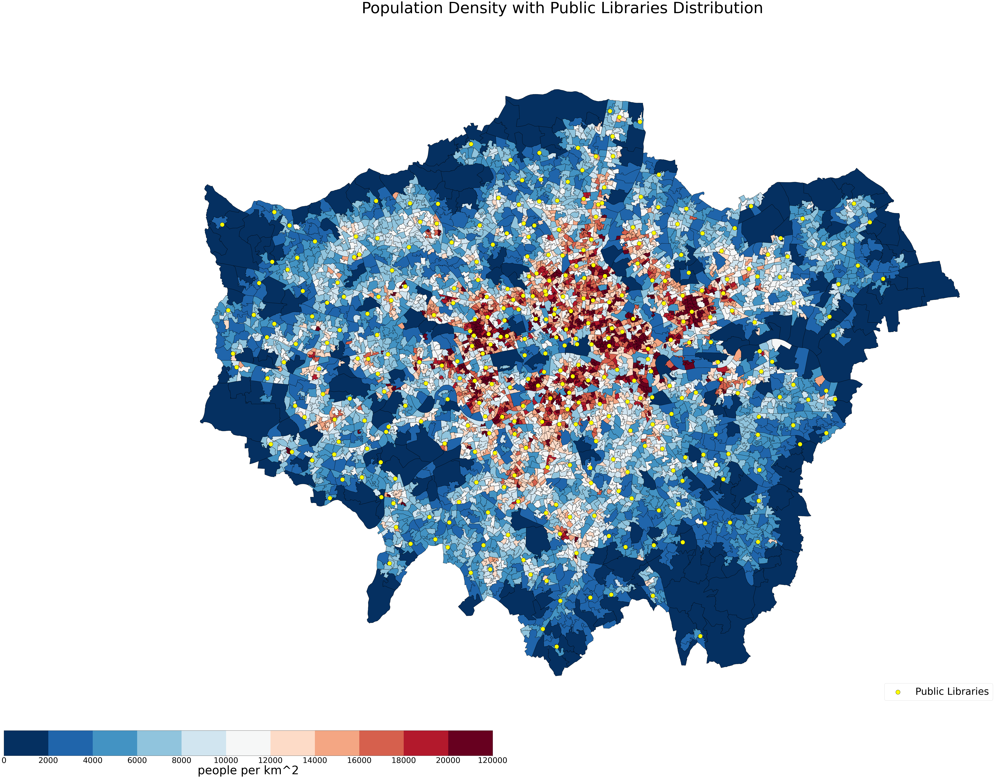

In [131]:
import geopandas as gpd
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors
import numpy as np

# 将Final_df转换为GeoDataFrame
London_population_density_gpd = gpd.GeoDataFrame(London_population_density, geometry='geometry')

# 设置颜色映射的最小值和最大值
vmin = London_population_density_gpd['People_per_Sq_Km'].min()
vmax = 20000  # 手动设置 colorbar 的最大值为 20000

# 自定义区间
boundaries = [0, 2000, 4000, 6000, 8000, 10000, 12000, 14000, 16000, 18000, 20000, 120000]
norm = mcolors.BoundaryNorm(boundaries, ncolors=256, clip=True)

# 绘制地图并根据 People_per_Sq_Km 列的值进行着色
fig, ax = plt.subplots(1, 1, figsize=(100, 60))  # 调整大小为更适合屏幕显示的比例
cmap = 'RdBu_r'

# 使用GeoDataFrame的plot函数来绘制地图
London_population_density_gpd.plot(column='People_per_Sq_Km', cmap=cmap, legend=False, norm=norm, ax=ax, edgecolor='black')

# 叠加图书馆位置点，使用黄色填充和黑色描边
destinations_all.plot(ax=ax, marker='o', color='yellow', edgecolor='black', markersize=500, label='Public Libraries')

# 隐藏坐标轴
ax.axis('off')

# 手动创建横置的 colorbar，并将其放置在图的左半边
sm = plt.cm.ScalarMappable(cmap=cmap, norm=norm)
sm.set_array([])

# 在指定位置创建 colorbar 的轴并横置
cbar_ax = fig.add_axes([0.1, 0.05, 0.35, 0.03])  # [left, bottom, width, height]
cbar = fig.colorbar(sm, cax=cbar_ax, orientation='horizontal', boundaries=boundaries)
cbar.set_label('people per km^2', fontsize=60)  # 设置 colorbar 标签的字体大小
cbar.ax.tick_params(labelsize=40)  # 设置 colorbar 刻度标签的字体大小
cbar.set_ticks(boundaries)  # 设置 colorbar 的刻度

# 在右侧添加公共图书馆的图例
ax.legend(loc='lower right', fontsize=50)

# 调整标题位置，使其位于图的上方
fig.suptitle('Population Density with Public Libraries Distribution', fontsize=80, y=0.95)

# 保存图片到指定路径
plt.savefig("Plot_final_0826/Population_Density_Public_Libraries_Distribution_with_Legend_Draft2.png")

plt.show()
